In [1]:
using Flux, Statistics
using Flux.Data: DataLoader
using Flux: onehotbatch, onecold, @epochs
using Flux.Losses: logitcrossentropy
using Base: @kwdef
using MLDatasets
using Plots

In [3]:
include("src/network.jl")
include("src/vsa.jl")
include("src/spiking.jl")

zero_nans (generic function with 1 method)

# Load the dataset

In [4]:
function getdata(args)
    ENV["DATADEPS_ALWAYS_ACCEPT"] = "true"

    @info "Getting and transforming data"

    ## Load dataset
    xtrain, ytrain = MLDatasets.FashionMNIST(:train)[:]
    xtest, ytest = MLDatasets.FashionMNIST(:test)[:]

    ## Reshape input data to flatten each image into a linear array
    xtrain = Flux.flatten(xtrain)
    xtest = Flux.flatten(xtest)

    ## One-hot-encode the labels
    ytrain, ytest = onehotbatch(ytrain, 0:9), onehotbatch(ytest, 0:9)

    ## Create two DataLoader objects (mini-batch iterators)
    train_loader = DataLoader((xtrain, ytrain), batchsize=args.batchsize, shuffle=true)
    test_loader = DataLoader((xtest, ytest), batchsize=args.batchsize)

    return train_loader, test_loader
end

getdata (generic function with 1 method)

In [5]:
LayerNorm(1)

LayerNorm(1)        # 2 parameters

In [6]:
function build_model(; imgsize=(28,28,1), nclasses=10, nhidden::Int=128)
    return Chain(
                  PhasorDense(prod(imgsize) => nhidden),
                  PhasorDense(nhidden => nclasses))
end

build_model (generic function with 1 method)

In [7]:
@kwdef mutable struct Args
    η::Float64 = 3e-4       ## learning rate
    batchsize::Int = 256    ## batch size
    epochs::Int = 10        ## number of epochs
    use_cuda::Bool = false   ## use gpu (if cuda available)
end

Args

In [8]:
train_loader, test_loader = getdata(Args())

[ Info: Getting and transforming data


(DataLoader(::Tuple{Matrix{Float32}, OneHotArrays.OneHotMatrix{UInt32, Vector{UInt32}}}, shuffle=true, batchsize=256), DataLoader(::Tuple{Matrix{Float32}, OneHotArrays.OneHotMatrix{UInt32, Vector{UInt32}}}, batchsize=256))

In [9]:
x, y = first(train_loader)

(Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.5686275 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Bool[0 1 … 0 0; 0 0 … 0 0; … ; 1 0 … 0 0; 0 0 … 0 0])

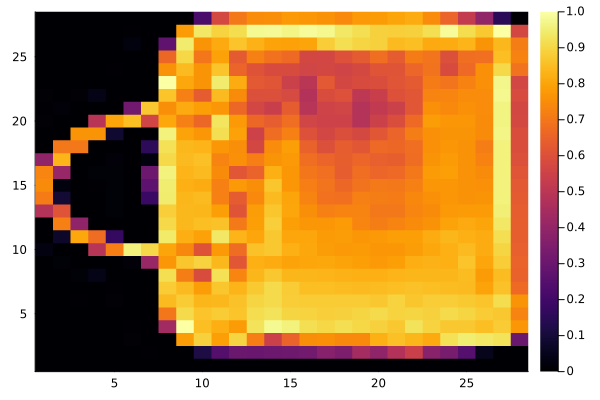

In [10]:
heatmap(reshape(x'[1,:], (28, 28)))

# Build the phasor model

In [11]:
phasor_model = build_model()

Chain(
  PhasorDense(784 => 128),              # 100_480 parameters
  PhasorDense(128 => 10),               # 1_290 parameters
)                   # Total: 4 arrays, 101_770 parameters, 398.328 KiB.

In [12]:
y_naive = phasor_model(x');

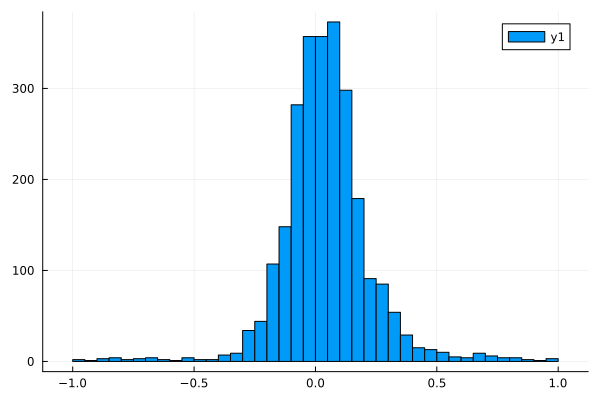

In [13]:
histogram(y_naive |> vec)

## test the correlation of static & dynamic phases

In [18]:
spk_args = SpikingArgs(2*pi, -0.2, 1.0, 0.02, 0.02, 0.03)

Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)


In [19]:
x_train = phase_to_train(x', spk_args, repeats = 10)

Spike Train: (256, 784) with 2007040 spikes.

In [20]:
x_call = SpikingCall(x_train, spk_args, (0.0, 10.0))

SpikingCall(Spike Train: (256, 784) with 2007040 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [21]:
y_spk_1 = phasor_model[1](x_call)

SpikingCall(Spike Train: (256, 128) with 321157 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [22]:
@time y_spk = phasor_model(x_call)

 27.862520 seconds (681.63 k allocations: 14.824 GiB, 1.03% gc time, 0.55% compilation time)


SpikingCall(Spike Train: (256, 10) with 23946 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [26]:
naive_spiking_phases = train_to_phase(y_spk);

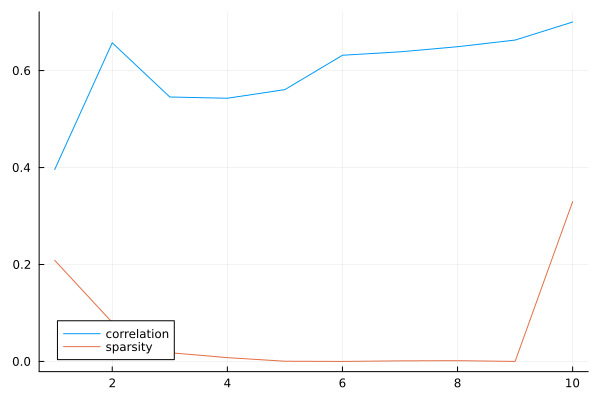

In [27]:
plot(cycle_correlation(y_naive, naive_spiking_phases), label="correlation")
plot!(count_nans(naive_spiking_phases) ./ prod(y_spk.train.shape), label="sparsity")

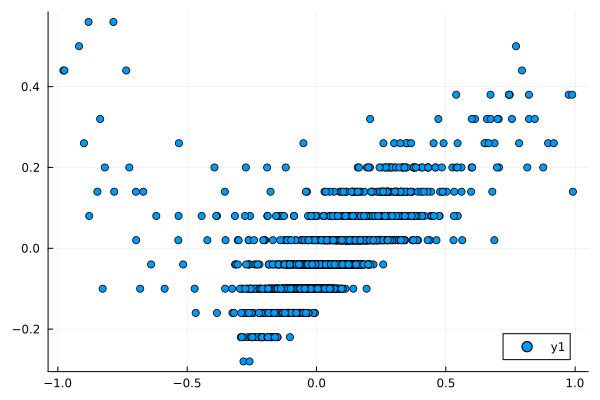

In [28]:
scatter(y_naive |> vec, naive_spiking_phases[5,:,:] |> vec)

## test the pre-train accuracy

In [29]:
mean(accuracy_quadrature(y_naive, y))

0.109375

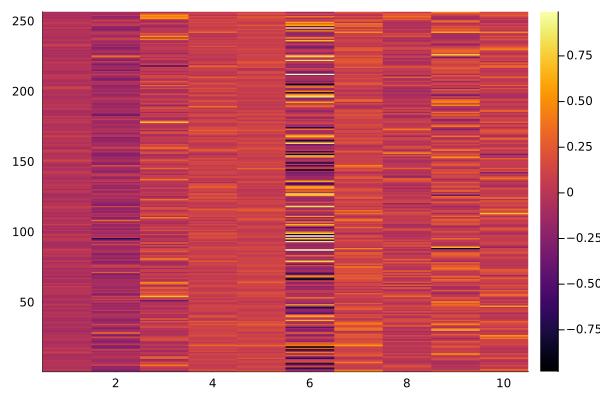

In [30]:
heatmap(y_naive)

In [33]:
function zero_nans(phases::AbstractArray)
    nans = isnan.(phases)
    phases[nans] .= 0.0
    return phases
end

zero_nans (generic function with 1 method)

In [34]:
function loss_and_accuracy(data_loader, model, mode="static")
    acc = 0
    ls = 0.0f0
    num = 0
    for (x, y) in data_loader
        ŷ = model(x')
        
        ls += sum(quadrature_loss(ŷ, y'))
        acc += sum(accuracy_quadrature(ŷ, y)) ## Decode the output of the model
        num +=  size(x)[end]
    end
    return ls / num, acc / num
end

loss_and_accuracy (generic function with 2 methods)

In [35]:
function accuracy(data_loader, model, spk_args::SpikingArgs, t_span::Tuple{<:Real, <:Real}; repeats::Int = 3)
    acc = []
    n_phases = []
    num = 0

    for (x, y) in data_loader
        train = phase_to_train(x', spk_args, repeats=repeats)
        call = SpikingCall(train, spk_args, t_span)
        spk_output = model(call)
        ŷ = train_to_phase(spk_output)
        
        append!(acc, sum.(accuracy_quadrature(ŷ, y))') ## Decode the output of the model
        num +=  size(x)[end]
    end

    return acc, num
end

accuracy (generic function with 1 method)

In [36]:
loss_and_accuracy(test_loader, phasor_model)

(0.21427256651884982, 0.1101)

In [37]:
right, num = accuracy(test_loader, phasor_model, spk_args, (0.0, 10.0))

(Any[23, 26, 23, 20, 23, 24, 26, 28, 29, 22  …  3, 4, 3, 4, 2, 2, 2, 3, 2, 4], 10000)

In [38]:
sum(reshape(right, 10, :), dims=2) ./ num

10×1 Matrix{Float64}:
 0.1021
 0.1087
 0.1086
 0.1108
 0.1172
 0.1234
 0.1262
 0.1325
 0.1435
 0.111

## Train the model

In [39]:
using Zygote: withgradient

In [40]:
function train(model; kws...)
    args = Args(; kws...) ## Collect options in a struct for convenience

    # if CUDA.functional() && args.use_cuda
    #     @info "Training on CUDA GPU"
    #     CUDA.allowscalar(false)
    #     device = gpu
    # else
        @info "Training on CPU"
        device = cpu
    # end

    ## Create test and train dataloaders
    train_loader, test_loader = getdata(args)

    @info "Constructing model and starting training"
    ## Construct model
    #model = build_model() |> device

    ## Optimizer
    opt = Flux.setup(Adam(args.η), model)
    losses = []

    ## Training
    for epoch in 1:args.epochs
        for (x, y) in train_loader
            x, y = transpose(device(x)), transpose(device(y)) ## transfer data to device
            loss, gs = withgradient(m -> mean(quadrature_loss(m(x), y)), model) ## compute gradient of the loss
            append!(losses, loss)
            Flux.Optimise.update!(opt, model, gs[1]) ## update parameters
        end

        ## Report on train and test
        train_loss, train_acc = loss_and_accuracy(train_loader, model)
        test_loss, test_acc = loss_and_accuracy(test_loader, model)
        println("Epoch=$epoch")
        println("  train_loss = $train_loss, train_accuracy = $train_acc")
        println("  test_loss = $test_loss, test_accuracy = $test_acc")
    end

    return losses
end

train (generic function with 1 method)

In [41]:
opt = Flux.setup(Adam(3e-4), phasor_model)

(layers = ((weight = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), ([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], (0.9, 0.999)))), (weight = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), ([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], (0.9, 0.999))))),)

In [42]:
l = train(phasor_model)

[ Info: Training on CPU
[ Info: Getting and transforming data
[ Info: Constructing model and starting training


Epoch=1
  train_loss = 0.03764796945014213, train_accuracy = 0.8173166666666667
  test_loss = 0.03887528390145566, test_accuracy = 0.808
Epoch=2
  train_loss = 0.0318584275934619, train_accuracy = 0.8432
  test_loss = 0.03366481602807296, test_accuracy = 0.8295
Epoch=3
  train_loss = 0.029501368975532526, train_accuracy = 0.8545333333333334
  test_loss = 0.031389333131177415, test_accuracy = 0.8415
Epoch=4
  train_loss = 0.028289507936149188, train_accuracy = 0.8626333333333334
  test_loss = 0.030615271211763644, test_accuracy = 0.8453
Epoch=5
  train_loss = 0.026669970908899672, train_accuracy = 0.8683666666666666
  test_loss = 0.029115629187757303, test_accuracy = 0.8483
Epoch=6
  train_loss = 0.02593532067264304, train_accuracy = 0.8724666666666666
  test_loss = 0.028544880897271138, test_accuracy = 0.8496
Epoch=7
  train_loss = 0.02490343441768855, train_accuracy = 0.8776833333333334
  test_loss = 0.02775784568747351, test_accuracy = 0.858
Epoch=8
  train_loss = 0.02425929116262514

2350-element Vector{Any}:
 0.2140781461460585
 0.1605154135780744
 0.13252598147328992
 0.13016466190339274
 0.11127366210269679
 0.1081912202972279
 0.10393576376992356
 0.09930686465602964
 0.09674744367992574
 0.08961701603381961
 0.08661395726038236
 0.08638726791921077
 0.0860396181511702
 ⋮
 0.02201532799368543
 0.02278573346567147
 0.0245189200976509
 0.026181870591306573
 0.020666776863567052
 0.02186606517294136
 0.02641512840942043
 0.027881830274282586
 0.027196381714433414
 0.02571022384178152
 0.026609251990371202
 0.023355898652036366

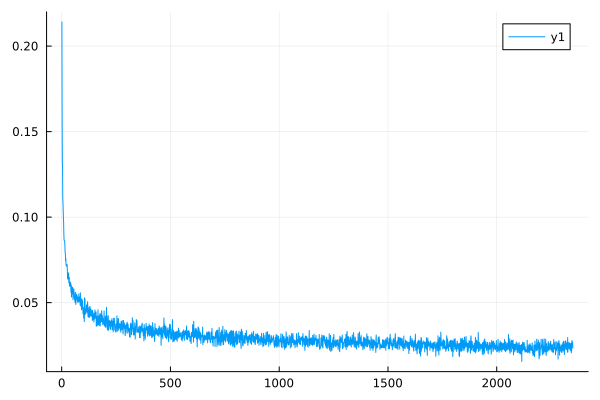

In [43]:
plot(l)

In [44]:
y_pred = phasor_model(x');

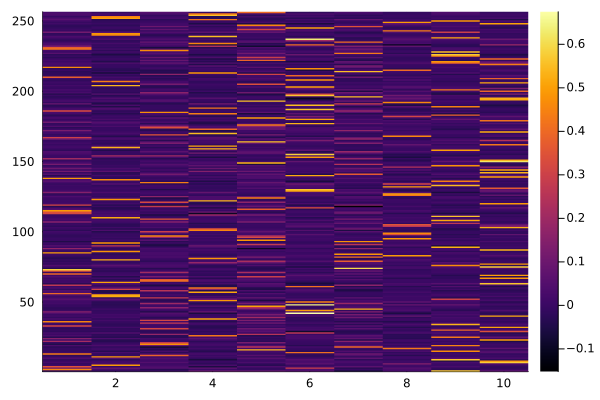

In [45]:
heatmap(y_pred)

In [46]:
y_layer1 = phasor_model[1](x');

In [47]:
y_layer1_spk = phasor_model[1](x_call)

SpikingCall(Spike Train: (256, 128) with 319937 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [48]:
y_spk = phasor_model(x_call)

SpikingCall(Spike Train: (256, 10) with 25174 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [49]:
y_layer1_phase = train_to_phase(y_layer1_spk);

In [50]:
y_phase = train_to_phase(y_spk);

In [51]:
scatter(y_layer1 |> vec, y_layer1_phase[2,:,:] |> vec, alpha=0.02)

In [52]:
scatter(y_layer1 |> vec, y_layer1_phase[3,:,:] |> vec, alpha=0.02)

In [53]:
scatter(y_layer1 |> vec, y_layer1_phase[4,:,:] |> vec, alpha=0.02)

In [54]:
scatter(y_layer1 |> vec, y_layer1_phase[5,:,:] |> vec, alpha=0.05)

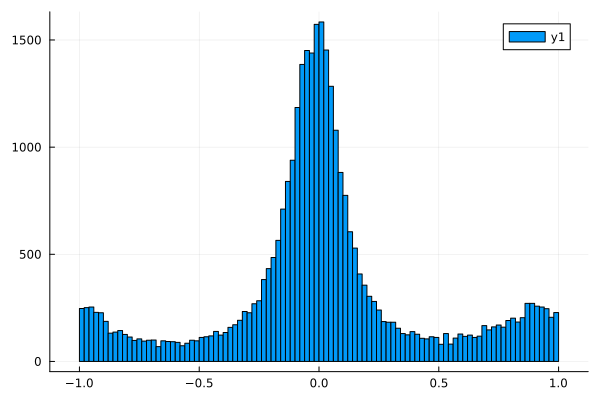

In [55]:
histogram(y_layer1 |> vec)

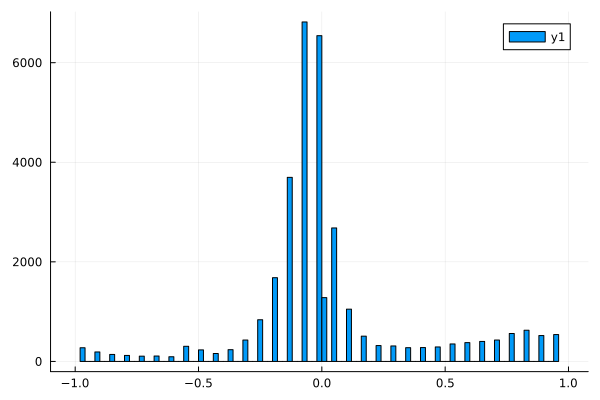

In [56]:
histogram(zero_nans(y_layer1_phase[2,:,:]) |> vec)

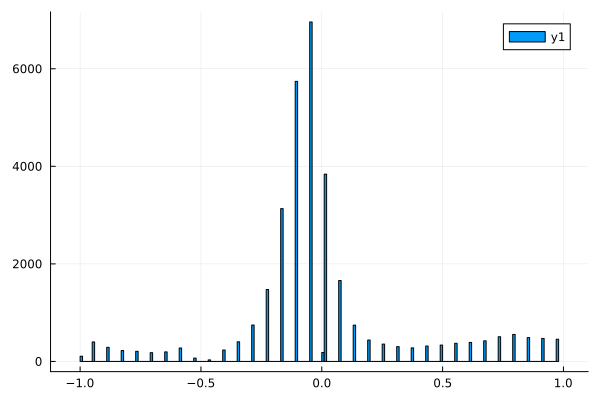

In [57]:
histogram(zero_nans(y_layer1_phase[3,:,:]) |> vec)

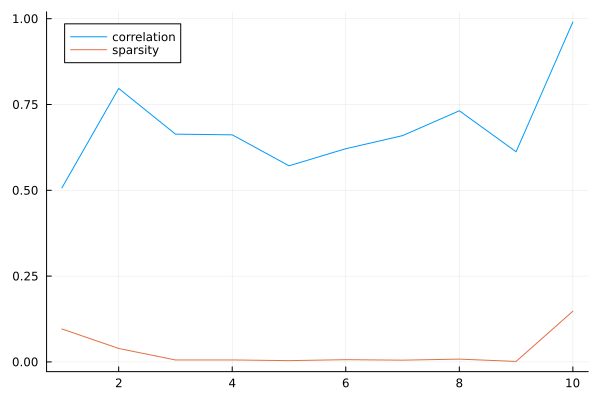

In [58]:
plot(cycle_correlation(y_layer1, y_layer1_phase), label="correlation")
plot!(count_nans(y_layer1_phase) ./ prod(y_layer1_spk.train.shape), label="sparsity")

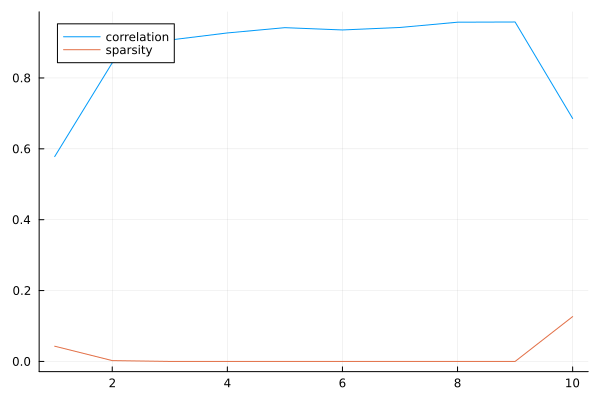

In [59]:
plot(cycle_correlation(y_pred, y_phase), label="correlation")
plot!(count_nans(y_phase) ./ prod(y_spk.train.shape), label="sparsity")

In [60]:
spk_accuracy =accuracy_quadrature(y_phase, y)

10-element Vector{BitMatrix}:
 [1; 1; … ; 0; 0;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 1;;]

In [61]:
sum.(spk_accuracy)

10-element Vector{Int64}:
 130
 201
 215
 217
 218
 221
 220
 220
 220
 203

In [62]:
loss_and_accuracy(test_loader, phasor_model)

(0.026368657661941308, 0.8625)

In [63]:
right, num = accuracy(test_loader, phasor_model, spk_args, (0.0, 10.0), repeats=10)

(Any[146, 218, 220, 222, 223, 223, 224, 224, 225, 216  …  12, 15, 14, 14, 14, 15, 15, 14, 14, 14], 10000)

In [69]:
spk_accs = sum(reshape(right, 10, :), dims=2) ./ num

10×1 Matrix{Float64}:
 0.5205
 0.7967
 0.8332
 0.8451
 0.8496
 0.8503
 0.8531
 0.853
 0.8515
 0.804

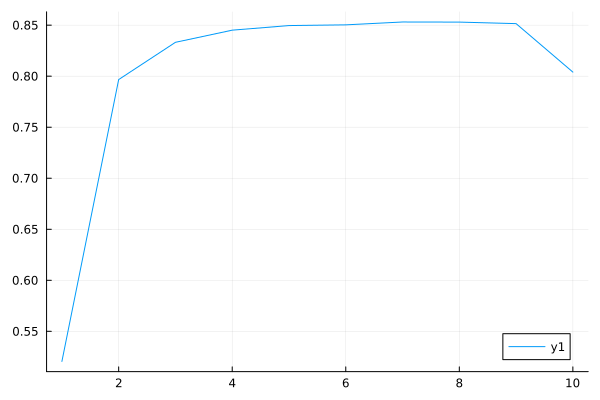

In [70]:
plot(spk_accs)